<a href="https://colab.research.google.com/github/tavleenbajwa8/Time_Series_Sales_Forecast/blob/main/Gofoqal_Tavleen_Bajwa_11_2_24.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Problem Statement: Predict 3 months of item-level sales at different store locations

# Data Fields: Date, Store_Ids, Item_Ids, Sales


# Worflow:

1. Did basic data exploration to check statistics, handle missing values
2. Exploratory Data Analysis of Sales distribution only, Sales distribution across each store and Sales distribution in store across each item
3. Correalation Analysis, Outlier Detection
4. Seasonal Decompose to check Seasonal, Trend and Residual through visual inspection
5. Aggregating the sales by day,store and items to do Exploratory Data Analysis across each category
5. Visual inspection of seasonality and trend in all 3 aggregated data followed by Stationarity Check using Augmented Dickey-Fuller (ADF) Test
6. Differencing: To remove the trend component from the time series data, making it more stationary and suitable for analysis using techniques that assume stationarity
7. Autocorrelation and Partial Autocorrelation Analysis to understand relationship between different time lags
8. Feature Engineering & Modelling using different Models
9. Univariate Modelling using Sales column only (without Feature Engineering) -- ARIMA & SARIMAX Models followed by Visual inspection between Predicted and Actual
10. Multivariate Modelling with Feature Engineering: Adding extra features (year,month,day,weekday along with sales) -- ARIMA & SARIMAX Models followed by Visual inspection between Predicted and Actual
11. univariate Modelling using Multilayer Perceptron (with Feature Engineering -- Feature conversion from series to supervised) -- followed by Visual inspection between Predicted and Actual of last 90 days values
12. Multilayer Perceptron showed the best fit based on Visual inspection
13. MLP chosen for prediction of next 90 days of predict.csv in predictions_array -- Each value corresponds to date from (2018-01-01 to 2018-03-31)


# Limitations of Current Model
1. Train and Validation RMSE(Root Mean square error) were 15.006557492184522, 15.082496480198829 respectively, which is still huge irrespective
of good visual inspection
2. Hyperparamter Tuning is not done in the current model

# Future improvements
1. Explore techniques for multivariate analysis using deep learning
2. Hyperparameter Tuning
3. Explore more Deep Learning Algorithms to potentially improve forecasting accuracy.

# 1. Installing necessary libraries

In [ ]:
# !pip install keras tensorflow chart-studio

In [ ]:
# !pip install -U kaleido

# 2. Importing necessary libraries

In [ ]:

import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from keras import optimizers
from keras.utils import plot_model
from keras.models import Sequential, Model
from keras.layers import Conv1D, MaxPooling1D
from keras.layers import Dense, LSTM, RepeatVector, TimeDistributed, Flatten
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
import chart_studio.plotly as py
import plotly.graph_objs as go
# import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot
from statsmodels.tsa.stattools import adfuller
import seaborn as sns
import statsmodels.api as sm
from pylab import rcParams




%matplotlib inline
warnings.filterwarnings("ignore")
init_notebook_mode(connected=True)

import tensorflow as tf
import numpy as np

# Set seeds to make the experiment more reproducible.
np.random.seed(1)
tf.random.set_seed(1)

# 3. Basic Data Inspection

In [ ]:
#Reading train and test data

#As observed train data has the target variable (sales) whereas test data doesnt, which we have to predict in this time series forecasting
df_train = pd.read_csv("training_data.csv", parse_dates=['date'])
df_predict = pd.read_csv("predict_data.csv", parse_dates=['date'])

In [ ]:
df_train.head(5)

,date,store,item,sales
0,01-01-2013,1,1,13.0
1,02-01-2013,1,1,11.0
2,03-01-2013,1,1,14.0
3,04-01-2013,1,1,13.0
4,05-01-2013,1,1,10.0


In [ ]:
df_predict.head(5)

,id,date,store,item
0,0,2018-01-01,1,1
1,1,2018-01-02,1,1
2,2,2018-01-03,1,1
3,3,2018-01-04,1,1
4,4,2018-01-05,1,1


In [ ]:
#Checking shape of data
print(df_train.shape)
print(df_predict.shape)

(913000, 4)
(45000, 4)


In [ ]:
#Checking the datatypes
print(df_train.dtypes)
print(df_predict.dtypes)

date      object
store      int64
item       int64
sales    float64
dtype: object
id                int64
date     datetime64[ns]
store             int64
item              int64
dtype: object


# Handling Missing Values

In [ ]:
#Checking for Null values
df_train.isna().sum()

date         0
store        0
item         0
sales    15648
dtype: int64

In [ ]:
#Percentage of Na values comapred to whole data
missing_values = df_train.isna().sum().sum()
total_entries = df_train.shape[0]
percentage_missing = (missing_values / total_entries) * 100
print("Percentage of NaN values compared to whole data:", percentage_missing)

Percentage of NaN values compared to whole data: 1.7139101861993429


In [ ]:
#Since the percentage of NA values compared to whole dataset is fairly less, so can be dropped
#otherwise can be imputed with mean since its a continuous variable (in cases of less train data)
df_train = df_train.dropna()
df_train.reset_index(drop=True, inplace=True)
df_train

,date,store,item,sales
0,01-01-2013,1,1,13.0
1,02-01-2013,1,1,11.0
2,03-01-2013,1,1,14.0
3,04-01-2013,1,1,13.0
4,05-01-2013,1,1,10.0
...,...,...,...,...
897347,27-12-2017,10,50,63.0
897348,28-12-2017,10,50,59.0
897349,29-12-2017,10,50,74.0
897350,30-12-2017,10,50,62.0


In [ ]:
# Converting 'date' column to datetime objects
df_train['date'] = pd.to_datetime(df_train['date'], format="%d-%m-%Y")

In [ ]:
#Checking the actual time period for which we have the training data

print('Min date from train set: %s' % df_train['date'].min().date())
print('Max date from train set: %s' % df_train['date'].max().date())

print('Min date from predict set: %s' % df_predict['date'].min().date())
print('Max date from predict set: %s' % df_predict['date'].max().date())

print('Total unique stores:', df_train["store"].nunique())
unique_items_per_store = df_train.groupby('store')['item'].nunique()
print(unique_items_per_store)
#We have in total 5 years of data

Min date from train set: 2013-01-01
Max date from train set: 2017-12-31
Min date from predict set: 2018-01-01
Max date from predict set: 2018-03-31
Total unique stores: 10
store
1     50
2     50
3     50
4     50
5     50
6     50
7     50
8     50
9     50
10    50
Name: item, dtype: int64


In [ ]:
#Calculating the lag_size, which is amount of days we need to forecast

lag_size = (df_predict['date'].max().date() - df_train['date'].max().date()).days
print(lag_size)

#We need to forecast for 90 days

90


Statistical Summary: Since store snd item are ids, we would focus on target variable = "sales" here for Descriptive Stats

1. Mean: Indicates the average sales volume across all observations, which is approximately 52.35.

2. Sstandard deviation: Measures the variability of the sales data around the mean, which is approximately 28.78.

3. The 'min' and 'max' values indicate the minimum and maximum sales volumes observed in the dataset, respectively, with the minimum being 0 and the maximum being 231.

4. The '25%', '50%', and '75%' percentiles give insights into the distribution of sales volume, with 25% of the data falling below 30, 50% falling below 47, and 75% falling below 70.

In [ ]:
df_train.describe()

,date,store,item,sales
count,897352,897352.000000,897352.000000,897352.000000
mean,2015-07-01 18:53:05.243694848,5.495177,25.494680,52.352136
min,2013-01-01 00:00:00,1.000000,1.000000,0.000000
25%,2014-04-01 00:00:00,3.000000,13.000000,30.000000
50%,2015-06-27 00:00:00,5.500000,25.000000,47.000000
75%,2016-10-05 00:00:00,8.000000,38.000000,70.000000
max,2017-12-31 00:00:00,10.000000,50.000000,231.000000
std,NaN,2.874654,14.438143,28.778559


In [ ]:
df_train

,date,store,item,sales
0,2013-01-01,1,1,13.0
1,2013-01-02,1,1,11.0
2,2013-01-03,1,1,14.0
3,2013-01-04,1,1,13.0
4,2013-01-05,1,1,10.0
...,...,...,...,...
897347,2017-12-27,10,50,63.0
897348,2017-12-28,10,50,59.0
897349,2017-12-29,10,50,74.0
897350,2017-12-30,10,50,62.0


In [ ]:
#As we know that sales data will vary depending on yearly, monthly,,weekly so we would add some extra columns to study that aswell
# df_train['date'] = pd.to_datetime(df_train['date'], format="%d-%m-%Y")
df_train['year'] = df_train['date'].dt.year
df_train['month'] = df_train['date'].dt.month
df_train['day'] = df_train['date'].dt.dayofyear
df_train['weekday'] = df_train['date'].dt.weekday


df_predict['year'] = df_predict['date'].dt.year
df_predict['month'] = df_predict['date'].dt.month
df_predict['day'] = df_predict['date'].dt.dayofyear
df_predict['weekday'] = df_predict['date'].dt.weekday

In [ ]:
df_train.head(5)

,date,store,item,sales,year,month,day,weekday
0,2013-01-01,1,1,13.0,2013,1,1,1
1,2013-01-02,1,1,11.0,2013,1,2,2
2,2013-01-03,1,1,14.0,2013,1,3,3
3,2013-01-04,1,1,13.0,2013,1,4,4
4,2013-01-05,1,1,10.0,2013,1,5,5


In [ ]:
df_predict.head(5)

,id,date,store,item,year,month,day,weekday
0,0,2018-01-01,1,1,2018,1,1,0
1,1,2018-01-02,1,1,2018,1,2,1
2,2,2018-01-03,1,1,2018,1,3,2
3,3,2018-01-04,1,1,2018,1,4,3
4,4,2018-01-05,1,1,2018,1,5,4


# 4. Exploratory Data Analysis

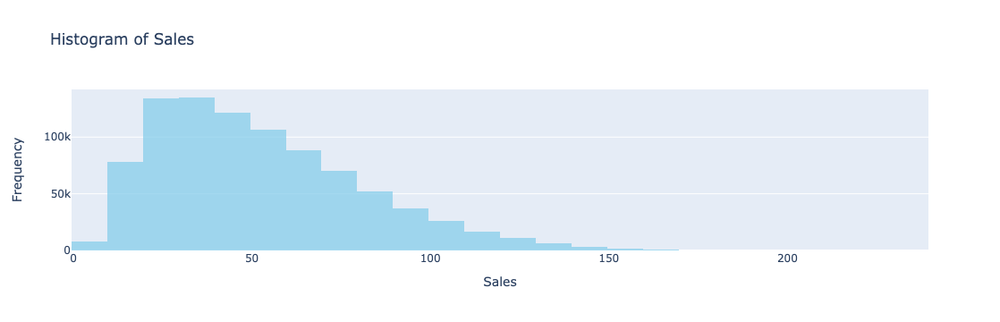

In [ ]:
# Creating a Histogram trace for sales
sales_histogram = go.Histogram(x=df_train['sales'],
                               xbins=dict(size=10),
                               marker=dict(color='skyblue'),
                               opacity=0.75)

# Defining the layout
layout = go.Layout(title='Histogram of Sales',
                   xaxis=dict(title='Sales'),
                   yaxis=dict(title='Frequency'))

# Creating a figure object
fig = go.Figure(data=[sales_histogram], layout=layout)

# Displaying the plot
fig.show()

#Sales distribution is right skewed: Majority of sales prices are concentrated towards the lower end, with fewer data points at higher sales prices

Text(0.5, 0.98, 'Histogram: Sales distribution at each store')

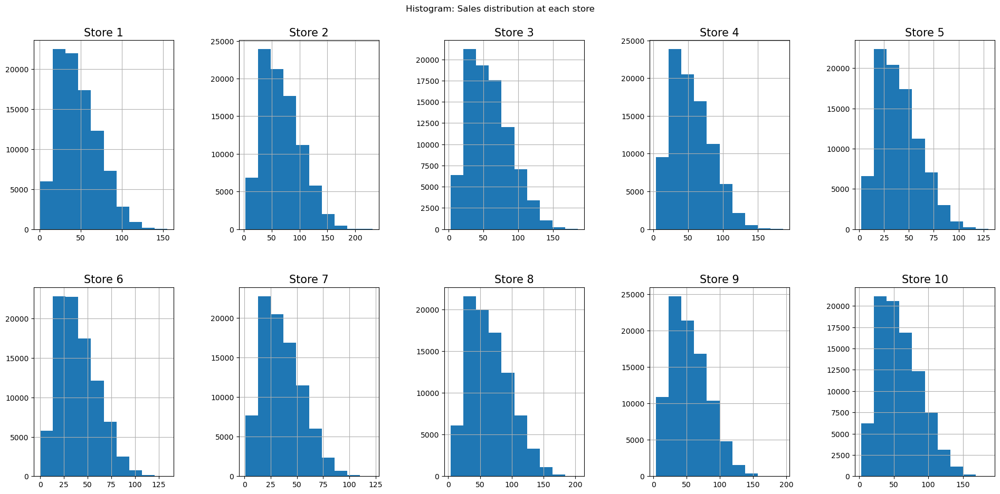

In [ ]:
#Lets visualize the histogram of sales distribution across each store

fig, axes = plt.subplots(2, 5, figsize=(20, 10))
for i in range(1,11):

    #Subplots in 1st row
    if i < 6:
        df_train[df_train.store == i].sales.hist(ax=axes[0, i-1])
        axes[0,i-1].set_title("Store " + str(i), fontsize = 15)

    #Subplots in 2nd row
    else:
        df_train[df_train.store == i].sales.hist(ax=axes[1, i - 6])
        axes[1,i-6].set_title("Store " + str(i), fontsize = 15)
plt.tight_layout(pad=4.5)
plt.suptitle("Histogram: Sales distribution at each store")

#Almost similar pattern was observed in all stores - Imparting that these stores are of same category

In [ ]:
#Sales distribution of each item in Store 1

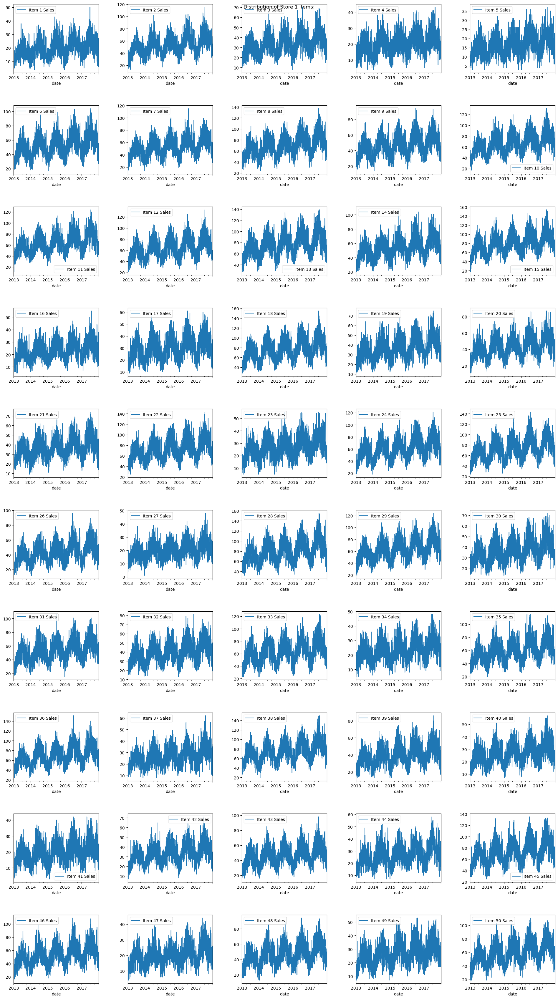

In [ ]:
store = 1
sub = df_train[df_train.store == store].set_index("date")

fig, axes = plt.subplots(10, 5, figsize=(20, 35))
for i in range(1,51):
    if i < 6:
        sub[sub.item == i].sales.plot(ax=axes[0, i-1], legend=True, label = "Item "+str(i)+" Sales")
    if i >= 6 and i<11:
        sub[sub.item == i].sales.plot(ax=axes[1, i - 6], legend=True, label = "Item "+str(i)+" Sales")
    if i >= 11 and i<16:
        sub[sub.item == i].sales.plot(ax=axes[2, i - 11], legend=True, label = "Item "+str(i)+" Sales")
    if i >= 16 and i<21:
        sub[sub.item == i].sales.plot(ax=axes[3, i - 16], legend=True, label = "Item "+str(i)+" Sales")
    if i >= 21 and i<26:
        sub[sub.item == i].sales.plot(ax=axes[4, i - 21], legend=True, label = "Item "+str(i)+" Sales")
    if i >= 26 and i<31:
        sub[sub.item == i].sales.plot(ax=axes[5, i - 26], legend=True, label = "Item "+str(i)+" Sales")
    if i >= 31 and i<36:
        sub[sub.item == i].sales.plot(ax=axes[6, i - 31], legend=True, label = "Item "+str(i)+" Sales")
    if i >= 36 and i<41:
        sub[sub.item == i].sales.plot(ax=axes[7, i - 36], legend=True, label = "Item "+str(i)+" Sales")
    if i >= 41 and i<46:
        sub[sub.item == i].sales.plot(ax=axes[8, i - 41], legend=True, label = "Item "+str(i)+" Sales")
    if i >= 46 and i<51:
        sub[sub.item == i].sales.plot(ax=axes[9, i - 46], legend=True, label = "Item "+str(i)+" Sales")
plt.tight_layout(pad=4.5)
plt.suptitle("Distribution of Store 1 items:");

#Most of the items follow same trend of sales

# Note:
Since all the stores had similar distribution, we can filter our training set for any 1 store so that it will have lesser data to train on than the current volume which is very huge (computationally intensive)
.Also if we further like to reduce the training set then we can choose a specific item as well.

# Correlation Analysis

Correlation Analysis using Spearman coefficient: Spearman's rank correlation coefficient does not assume a linear relationship between variables. It evaluates the monotonic relationship between two variables, which means it captures patterns where the variables tend to move together in the same direction, even if the relationship is not strictly linear.

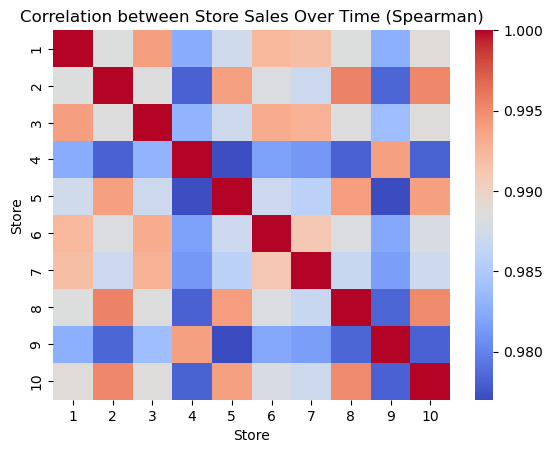

In [ ]:
#Correlation between total sales of stores

# Assuming 'df_train' contains your sales data
storesales = df_train.groupby(["date", "store"]).sales.sum().reset_index().set_index("date")

# Calculate correlation matrix
corr = pd.pivot_table(storesales, values="sales", columns="store", index="date").corr(method="spearman")

sns.heatmap(corr, cmap="coolwarm", fmt=".2f", annot_kws={"size": 10})
plt.title("Correlation between Store Sales Over Time (Spearman)")
plt.xlabel("Store")
plt.ylabel("Store")
plt.show()

#Almost all of them have high correlation among sale patterns (0.97 to 1) -- High Positive Correlation
#This further validates our assumption to go for single store rather than training on the whole set

# Checking for Outliers

In [ ]:
# df_train

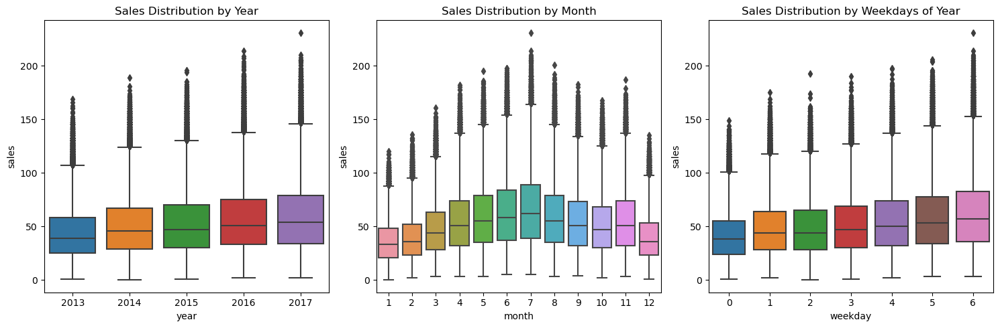

In [ ]:
# Creating subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Boxplot for sales by year
sns.boxplot(x="year", y="sales", data=df_train, ax=axes[0])
axes[0].set_title("Sales Distribution by Year")

# Boxplot for sales by month
sns.boxplot(x="month", y="sales", data=df_train, ax=axes[1])
axes[1].set_title("Sales Distribution by Month")

# Boxplot for sales by day
sns.boxplot(x="weekday", y="sales", data=df_train, ax=axes[2])
axes[2].set_title("Sales Distribution by Weekdays of Year")

plt.tight_layout()
plt.show()

#Observations

1. Here we can observe that highest sale was in the year "2017", month for highest sales was "July".
2. Weekends(5,6) has a larger sales, weekdays(0-4) are smaller
3. Also alot of outliers have been observed in each year,month,weekdays but observing outliers consistently across different time periods (years, months, weekdays), it suggests that these outliers may be driven by common factors that repeat over time.

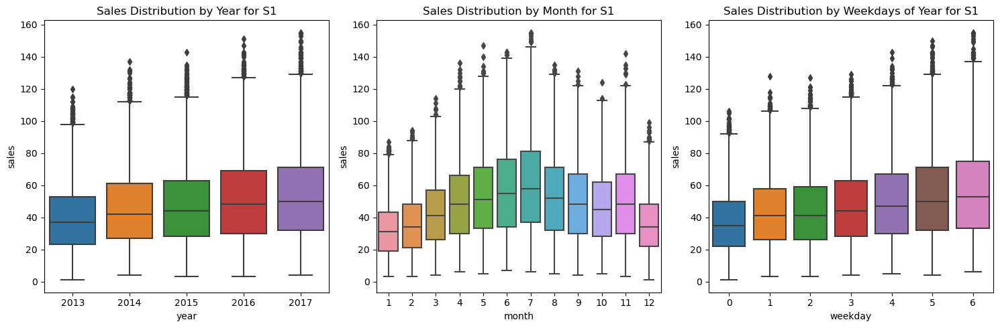

In [ ]:
#Lets try for 1 specific store
df_train_s1 = df_train[df_train["store"] == 1]

# Creating subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Boxplot for sales by year
sns.boxplot(x="year", y="sales", data=df_train_s1, ax=axes[0])
axes[0].set_title("Sales Distribution by Year for S1")

# Boxplot for sales by month
sns.boxplot(x="month", y="sales", data=df_train_s1, ax=axes[1])
axes[1].set_title("Sales Distribution by Month for S1")

# Boxplot for sales by day
sns.boxplot(x="weekday", y="sales", data=df_train_s1, ax=axes[2])
axes[2].set_title("Sales Distribution by Weekdays of Year for S1")

plt.tight_layout()
plt.show()


#Note: Here we see outliers in the data, because our data is right skewed, which means that the items brought
at higher price are low. Since our model will be dealing with such outliers in future. It wont be a good idea to
remove them completely because it might lead to failure of model while encountering such cases.

In [ ]:
#Seasonal decompose to understand the data better
# df_train = df_train.set_index('date')
# df_train['sales'] = df_train['sales'].astype(float)
# df_train.head()

# Seasonal Decompose

Time series decomposition is a mathematical procedure which transforms a time series into multiple different time series. The original time series is often split into 3 component series:

1. Seasonal: Patterns that repeat with a fixed period of time. For example, a website might receive more visits during weekends; this would produce data with a seasonality of 7 days.

2. Trend: The underlying trend of the metrics. A website increasing in popularity should show a general trend that goes up.

3. Residual: Also call “noise”, “irregular” or “remainder,” this is the residuals of the original time series after the seasonal and trend series are removed.

In [ ]:
df_train

,date,store,item,sales,year,month,day,weekday
0,2013-01-01,1,1,13.0,2013,1,1,1
1,2013-01-02,1,1,11.0,2013,1,2,2
2,2013-01-03,1,1,14.0,2013,1,3,3
3,2013-01-04,1,1,13.0,2013,1,4,4
4,2013-01-05,1,1,10.0,2013,1,5,5
...,...,...,...,...,...,...,...,...
897347,2017-12-27,10,50,63.0,2017,12,361,2
897348,2017-12-28,10,50,59.0,2017,12,362,3
897349,2017-12-29,10,50,74.0,2017,12,363,4
897350,2017-12-30,10,50,62.0,2017,12,364,5


In [ ]:
# df_train = df_train[df_train["store"] == 1]
# df_train.reset_index(drop=True, inplace=True)
# df_train

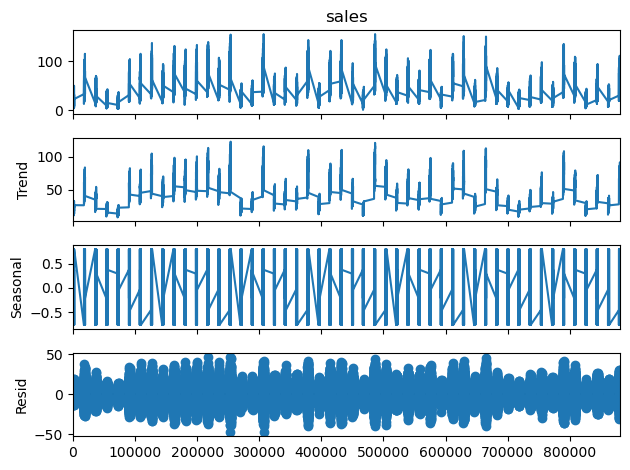

In [ ]:
#Seasonal decompose of Store 1
#Here we are assuming the data to have weekly seasonality
#Since the seasonal fluctuations are relatively constant, we will go for additive model
#When seasonal patterns tend to increase or decrease in proportion to the overall sales volume, multiplicative decomposition may be more appropriate.
decomposition = sm.tsa.seasonal_decompose(df_train_s1["sales"],period=7, model = 'additive')
figure = decomposition.plot()
plt.show()

1. There is a seasonal component, but it is very small in magnitude; trend does not seem significant either - we can suspect the process is stationary

2. But for clear inspection lets calculate p-value using ADF (Augmented Dickey-Fuller) Test to detect stationarity using p-value

In [ ]:
df_train

,date,store,item,sales,year,month,day,weekday
0,2013-01-01,1,1,13.0,2013,1,1,1
1,2013-01-02,1,1,11.0,2013,1,2,2
2,2013-01-03,1,1,14.0,2013,1,3,3
3,2013-01-04,1,1,13.0,2013,1,4,4
4,2013-01-05,1,1,10.0,2013,1,5,5
...,...,...,...,...,...,...,...,...
897347,2017-12-27,10,50,63.0,2017,12,361,2
897348,2017-12-28,10,50,59.0,2017,12,362,3
897349,2017-12-29,10,50,74.0,2017,12,363,4
897350,2017-12-30,10,50,62.0,2017,12,364,5


In [ ]:
# df_train.reset_index(inplace=True)

# Aggregating the sales by day,store and items

In [ ]:
df_train

,date,store,item,sales,year,month,day,weekday
0,2013-01-01,1,1,13.0,2013,1,1,1
1,2013-01-02,1,1,11.0,2013,1,2,2
2,2013-01-03,1,1,14.0,2013,1,3,3
3,2013-01-04,1,1,13.0,2013,1,4,4
4,2013-01-05,1,1,10.0,2013,1,5,5
...,...,...,...,...,...,...,...,...
897347,2017-12-27,10,50,63.0,2017,12,361,2
897348,2017-12-28,10,50,59.0,2017,12,362,3
897349,2017-12-29,10,50,74.0,2017,12,363,4
897350,2017-12-30,10,50,62.0,2017,12,364,5


In [ ]:
#Aggregating the sales by day,store and items

daily_sales = df_train.groupby('date', as_index=False)['sales'].sum()
store_daily_sales = df_train.groupby(['store', 'date'], as_index=False)['sales'].sum()
item_daily_sales = df_train.groupby(['item', 'date'], as_index=False)['sales'].sum()

In [ ]:
# daily_sales
# store_daily_sales
item_daily_sales

,item,date,sales
0,1,2013-01-01,80.0
1,1,2013-01-02,50.0
2,1,2013-01-03,71.0
3,1,2013-01-04,79.0
4,1,2013-01-05,93.0
...,...,...,...
91295,50,2017-12-27,511.0
91296,50,2017-12-28,587.0
91297,50,2017-12-29,596.0
91298,50,2017-12-30,612.0


In [ ]:
df_train

,date,store,item,sales,year,month,day,weekday
0,2013-01-01,1,1,13.0,2013,1,1,1
1,2013-01-02,1,1,11.0,2013,1,2,2
2,2013-01-03,1,1,14.0,2013,1,3,3
3,2013-01-04,1,1,13.0,2013,1,4,4
4,2013-01-05,1,1,10.0,2013,1,5,5
...,...,...,...,...,...,...,...,...
897347,2017-12-27,10,50,63.0,2017,12,361,2
897348,2017-12-28,10,50,59.0,2017,12,362,3
897349,2017-12-29,10,50,74.0,2017,12,363,4
897350,2017-12-30,10,50,62.0,2017,12,364,5


# 1. Daily Sales

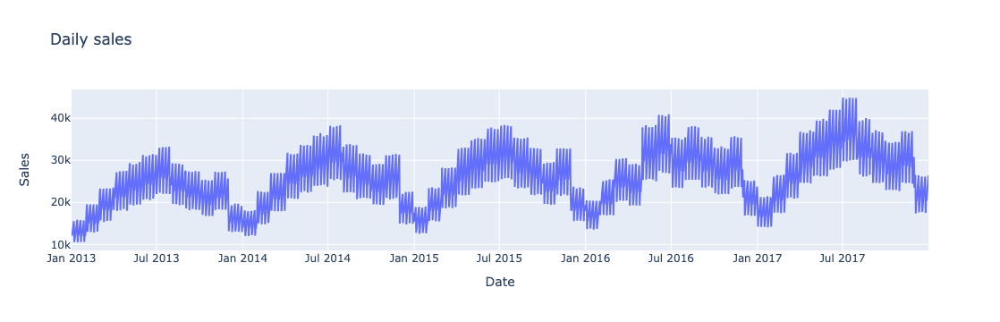

In [ ]:
import plotly.io as pio

daily_sales_sc = go.Scatter(x=daily_sales['date'], y=daily_sales['sales'])
layout = go.Layout(title='Daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))
fig = go.Figure(data=[daily_sales_sc], layout=layout)
iplot(fig)

1. Based on daily sales it shows that there is a trend on daily sales increasing in the month of June and July every year

2. This depicts Seasonality in the data according to visual inspection

In [ ]:
#Checking Stationarity in Data using Augmented Dickey-Fuller (ADF) Test
#Since we observe the trend in data, so we determine if the data is stationary around this trend.

sales_data = daily_sales['sales']
# Perform Augmented Dickey-Fuller (ADF) test
result = adfuller(sales_data)

# Extract and print the results
print('ADF Statistic:', result[0])
print('p-value:', result[1])
print('#Lags used:', result[2])
print('#Observations used:', result[3])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

# Interpret the results
if result[1] < 0.05:
    print("Reject the null hypothesis (H0), the data is stationary.")
else:
    print("Fail to reject the null hypothesis (H0), the data is non-stationary.")

ADF Statistic: -3.2983904144625065
p-value: 0.014950576497916073
#Lags used: 21
#Observations used: 1804
Critical Values:
	1%: -3.434
	5%: -2.863
	10%: -2.568
Reject the null hypothesis (H0), the data is stationary.


# 2. Store wise daily sales

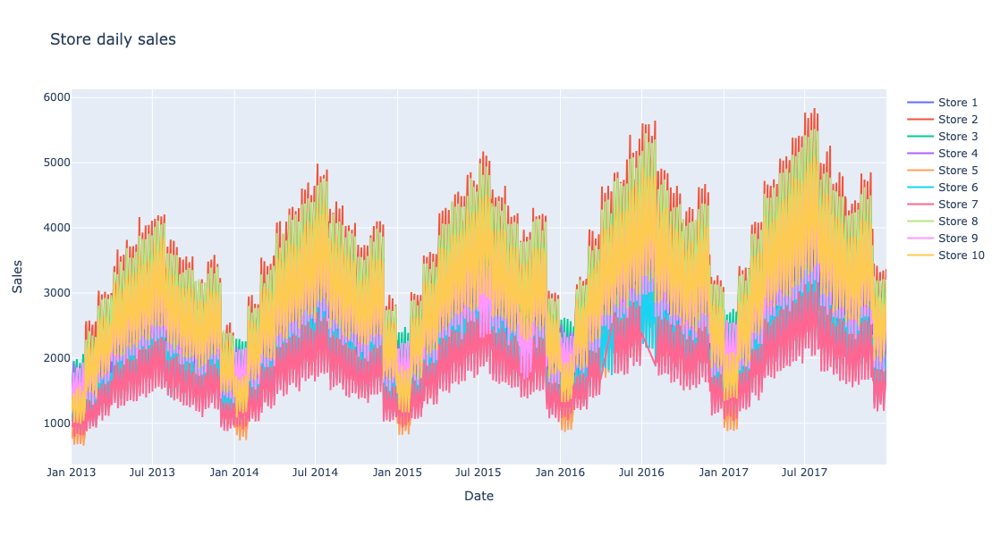

In [ ]:
store_daily_sales_sc = []
for store in store_daily_sales['store'].unique():
    current_store_daily_sales = store_daily_sales[(store_daily_sales['store'] == store)]
    store_daily_sales_sc.append(go.Scatter(x=current_store_daily_sales['date'], y=current_store_daily_sales['sales'], name=('Store %s' % store)))

layout = go.Layout(title='Store daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'), width=1000, height=600)
fig = go.Figure(data=store_daily_sales_sc, layout=layout)
iplot(fig)

In [ ]:
#Checking Stationarity in Data using Augmented Dickey-Fuller (ADF) Test
#Since we observe the trend in data, so we determine if the data is stationary around this trend.

sales_data = store_daily_sales['sales']
# Perform Augmented Dickey-Fuller (ADF) test
result = adfuller(sales_data)

# Extract and print the results
print('ADF Statistic:', result[0])
print('p-value:', result[1])
print('#Lags used:', result[2])
print('#Observations used:', result[3])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

# Interpret the results
if result[1] < 0.05:
    print("Reject the null hypothesis (H0), the data is stationary.")
else:
    print("Fail to reject the null hypothesis (H0), the data is non-stationary.")

ADF Statistic: -8.46547628166104
p-value: 1.526666551924471e-13
#Lags used: 42
#Observations used: 18095
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Reject the null hypothesis (H0), the data is stationary.


# 3. Item wise daily sales

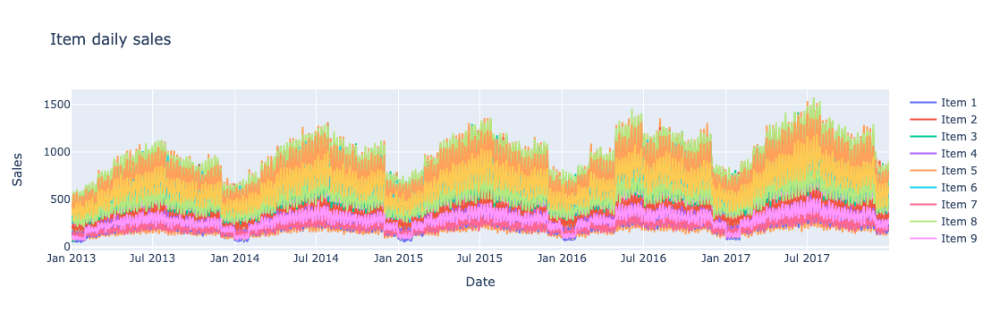

In [ ]:
item_daily_sales_sc = []
for item in item_daily_sales['item'].unique():
    current_item_daily_sales = item_daily_sales[(item_daily_sales['item'] == item)]
    item_daily_sales_sc.append(go.Scatter(x=current_item_daily_sales['date'], y=current_item_daily_sales['sales'], name=('Item %s' % item)))

layout = go.Layout(title='Item daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))
fig = go.Figure(data=item_daily_sales_sc, layout=layout)
iplot(fig)


In [ ]:
#Checking Stationarity in Data using Augmented Dickey-Fuller (ADF) Test
#Since we observe the trend in data, so we determine if the data is stationary around this trend.

# sales_data = np.log(item_daily_sales['sales'])
sales_data = item_daily_sales['sales']
# Perform Augmented Dickey-Fuller (ADF) test
result = adfuller(sales_data)

# Extract and print the results
print('ADF Statistic:', result[0])
print('p-value:', result[1])
print('#Lags used:', result[2])
print('#Observations used:', result[3])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

# Interpret the results
if result[1] <= 0.05:
    print("Reject the null hypothesis (H0), the data is stationary.")
else:
    print("Fail to reject the null hypothesis (H0), the data is non-stationary.")

ADF Statistic: -11.704110238682434
p-value: 1.5435651478267244e-21
#Lags used: 66
#Observations used: 91233
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
Reject the null hypothesis (H0), the data is stationary.


# Observation

Since the p-value is smaller in all cases, and null hypothesis is getting rejected, the data is stationary.It's actually not bad, if we use a 5% Critical Value(CV), this series would be considered stationary. But as we just found an upward trend in the visual inspection.

# Reducing Stationarity

Importnance of Stationarity

The mean and variance of the series should not be a function of time. They should remain constant
1. Mean and Variance Stability: In a stationary time series, the mean and variance remain constant over time. This means that the average value and the spread of the data do not exhibit any systematic trend or pattern. Stationarity ensures that the data does not exhibit any systematic biases or trends that could mislead the analysis.

2. Independence of Observations: Stationarity implies that observations in the time series are independent and identically distributed (i.i.d.), at least in a statistical sense. This assumption is crucial for many statistical methods and models, including linear regression. When observations are not independent, standard statistical techniques may produce biased or unreliable results.

# Testing Stationarity only on Store-1 data for better visualization

In [ ]:
df_train_ = df_train[df_train.store == 1]
df_train_

,date,store,item,sales,year,month,day,weekday
0,2013-01-01,1,1,13.0,2013,1,1,1
1,2013-01-02,1,1,11.0,2013,1,2,2
2,2013-01-03,1,1,14.0,2013,1,3,3
3,2013-01-04,1,1,13.0,2013,1,4,4
4,2013-01-05,1,1,10.0,2013,1,5,5
...,...,...,...,...,...,...,...,...
881035,2017-12-27,1,50,38.0,2017,12,361,2
881036,2017-12-28,1,50,52.0,2017,12,362,3
881037,2017-12-29,1,50,59.0,2017,12,363,4
881038,2017-12-30,1,50,66.0,2017,12,364,5


In [ ]:
from statsmodels.tsa.stattools import adfuller
#Here taking the window to as 7 (weekly) to compute rolling stats and Signicance level to be 0.01 (as we observed previously that 0.05 was not very strict)
def test_stationarity(timeseries, window = 7, cutoff = 0.01):

    #Determing rolling statistics
    rolmean = timeseries.rolling(window).mean()
    rolstd = timeseries.rolling(window).std()

    #Plot rolling statistics:
    fig = plt.figure(figsize=(12, 8))
    orig = plt.plot(timeseries, color='lightblue',label='Original')
    mean = plt.plot(rolmean, color='pink', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show()

    #Perform Dickey-Fuller test:
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC', maxlag = 20 )
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    pvalue = dftest[1]
    if pvalue < cutoff:
        print('p-value = %.4f. The series is likely stationary.' % pvalue)
    else:
        print('p-value = %.4f. The series is likely non-stationary.' % pvalue)

    print(dfoutput)


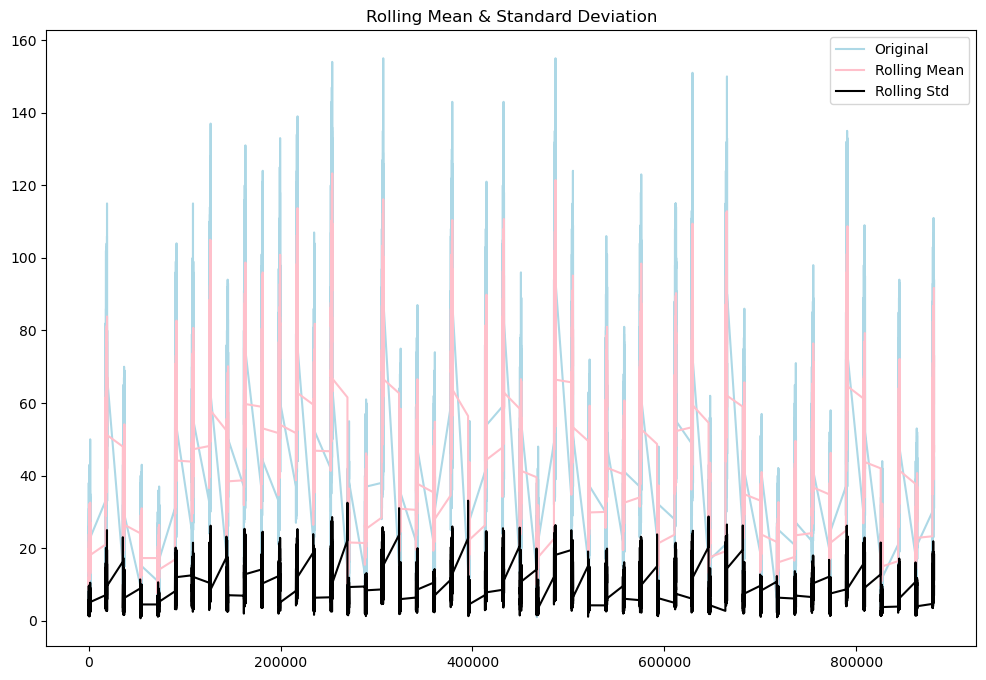

Results of Dickey-Fuller Test:
p-value = 0.0000. The series is likely stationary.
Test Statistic                -8.444610e+00
p-value                        1.726275e-13
#Lags Used                     2.000000e+01
Number of Observations Used    9.127900e+04
Critical Value (1%)           -3.430422e+00
Critical Value (5%)           -2.861572e+00
Critical Value (10%)          -2.566787e+00
dtype: float64


In [ ]:
test_stationarity(df_train_['sales'])

# Differencing

By performing differencing, we remove the trend component from the time series data, making it more stationary and suitable for analysis using techniques that assume stationarity.

difference(t)=observation(t)−observation(t−1)
observation(t): Represents the value of the time series at time 't', observation(t−1): Value at the previous time t-1

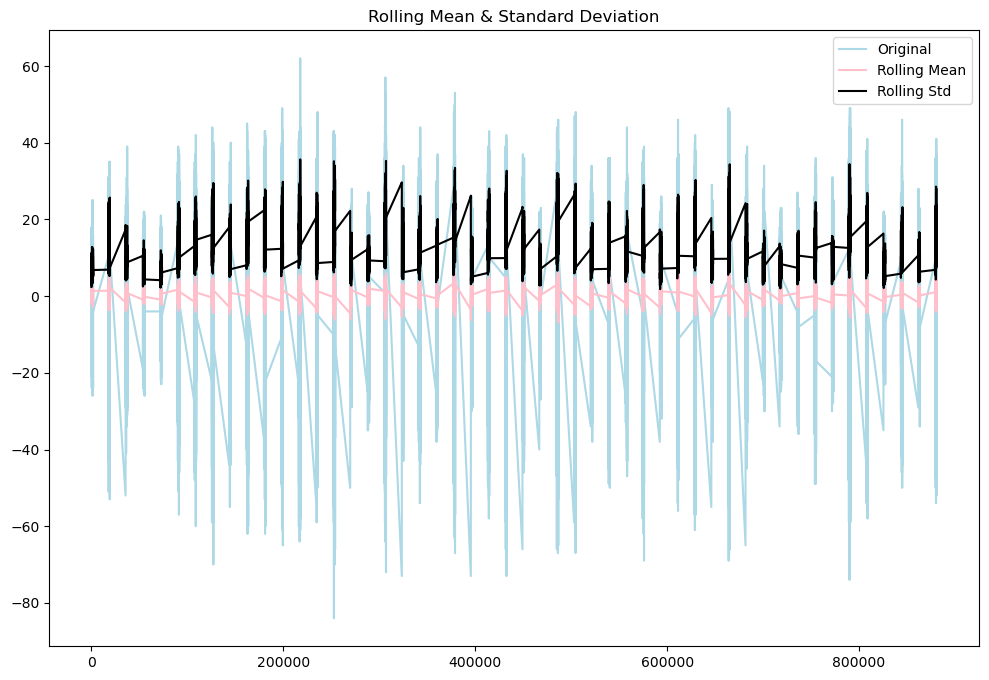

Results of Dickey-Fuller Test:
p-value = 0.0000. The series is likely stationary.
Test Statistic                   -92.892681
p-value                            0.000000
#Lags Used                        20.000000
Number of Observations Used    91278.000000
Critical Value (1%)               -3.430422
Critical Value (5%)               -2.861572
Critical Value (10%)              -2.566787
dtype: float64


In [ ]:
first_diff = df_train_.sales - df_train_.sales.shift(1)
first_diff = first_diff.dropna(inplace = False)
test_stationarity(first_diff, window = 12)

# Observation

1. Tested using different shifts, as you see the p-value for s1 store data here reduces and also the Test Static has become more negative (-8.44 to -92.89) when we did same for the whole dataset t-statitic became negative as well (-23.151601 to -288.569575) post differencing.


2. Chose shift to be 1, because it was give most negative test statistic. A more negative Test Statistic suggests stronger evidence against the null hypothesis, indicating a more likely stationarity.

# Autocorrelation and Partial Autocorrelation

#Correlation: An indicator of relationship between 2 variables
#Autocorrelation: Accounts for Direct and Indirect relationship of variable with its previous time period values(Lags)
#Partial Autocorrelation: Accounts for only Direct relationship of variable with its previous time period values(Lags)

#Moving Average Intuition: Model that predicts future values of a time series using the past errors


#1. ACF measures the correlation between the time series and its lagged values at different lags. It helps to identify the presence of autocorrelation in the time series data.
#2. PACF measures the correlation between the time series and its lagged values after removing the contributions of the intermediate lags.
#It helps to identify the direct (partial) correlation between two time points without the influence of other time points.

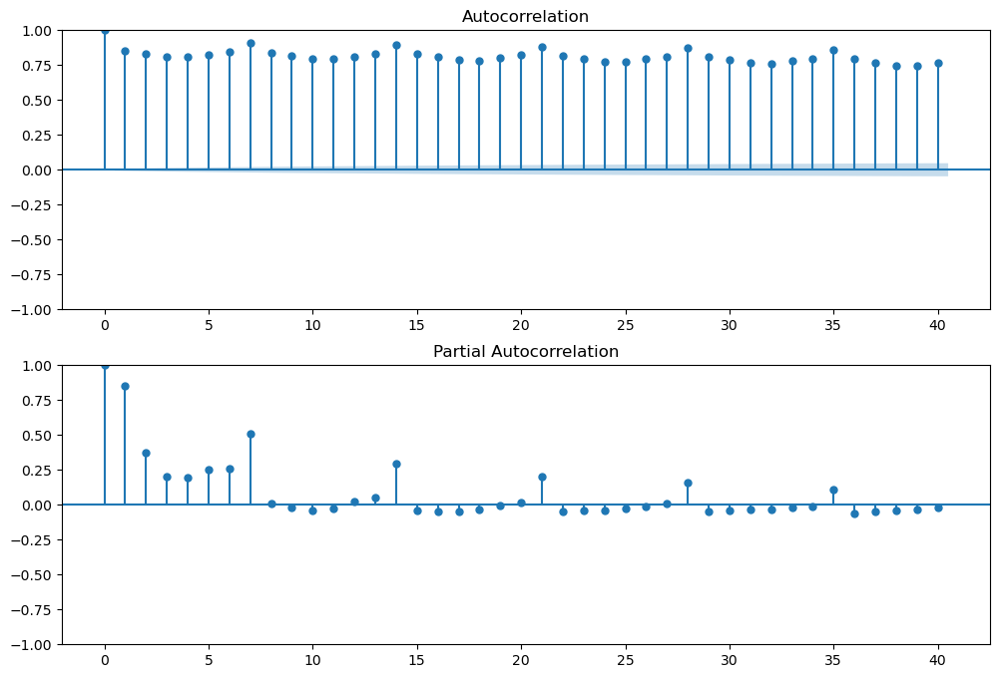

In [ ]:
import statsmodels.api as sm

fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_train_.sales, lags=40, ax=ax1)  #Took previous 40 lags here than the current time period
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_train_.sales, lags=40, ax=ax2)

In [ ]:
#ACF and PACF of first_diff

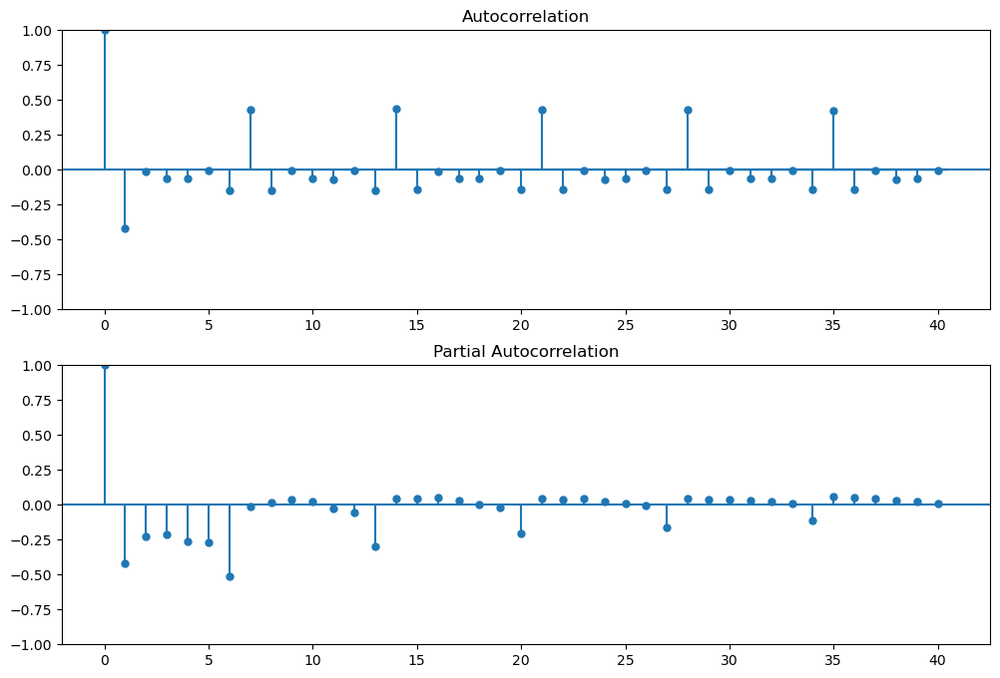

In [ ]:
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(first_diff, lags=40, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(first_diff, lags=40, ax=ax2)

# Observations

1. Difference between Normal vs Differenced Graph

After differencing, the ACF plot shows a sharp drop-off after a few lags, indicating that most of the correlation
has been removed. This is because differencing effectively removes the autocorrelation from the original series.
However, any remaining autocorrelation at specific lags may indicate a seasonal pattern.

2. Observation of Autocorrelation of the differenced series is negative at specific lags, such as lag 7, 14, 21, etc.,

Indicates a repeating pattern or seasonality in the data. In time series analysis, negative autocorrelation at
these lags suggests that the series exhibits a "reversed" pattern every certain number of time periods.

For example, if the autocorrelation is negative at lag 7, it implies that the observations tend to be lower than
average every 7 days, suggesting a weekly seasonality where the series experiences a downturn every week.


In this context, adding a Simple Moving Average (SMA) term to the model can help capture and account for this
seasonal pattern. SMA terms in time series models smooth out short-term fluctuations by averaging the data over
a specified number of periods. By incorporating an SMA term into the model, it can effectively capture the
repeating negative autocorrelation pattern observed at specific lags and improve the model's ability to forecast
the series accurately.

This can be done using SARIMA Model (Seasonal Autoregressive Integrated Moving Average (SARIMA) models. SARIMA models are specifically designed to handle time series data with seasonal patterns by incorporating seasonal terms into the model, allowing for better forecasting and capturing the underlying seasonal behavior of the data)

# 5. Feature Engineering and Modelling

# 1. Modelling without Feature Engineering (Using only "sales" column)

# 1.A Modelling using ARIMA

In [ ]:
df_train_.reset_index(drop=True, inplace=True)

In [ ]:
df_train_

,date,store,item,sales,year,month,day,weekday
0,2013-01-01,1,1,13.0,2013,1,1,1
1,2013-01-02,1,1,11.0,2013,1,2,2
2,2013-01-03,1,1,14.0,2013,1,3,3
3,2013-01-04,1,1,13.0,2013,1,4,4
4,2013-01-05,1,1,10.0,2013,1,5,5
...,...,...,...,...,...,...,...,...
91295,2017-12-27,1,50,38.0,2017,12,361,2
91296,2017-12-28,1,50,52.0,2017,12,362,3
91297,2017-12-29,1,50,59.0,2017,12,363,4
91298,2017-12-30,1,50,66.0,2017,12,364,5


In [ ]:
# p: Represents the number of lag observations included in the model, 7 previous time periods here
# d: Degree of differencing (1 shift)
# q: Size of the moving average window
arima_mod6 = sm.tsa.ARIMA(df_train_.sales, order=(7,1,0)).fit()
print(arima_mod6.summary())

                               SARIMAX Results                                
Dep. Variable:                  sales   No. Observations:                91300
Model:                 ARIMA(7, 1, 0)   Log Likelihood             -330436.610
Date:                Sun, 11 Feb 2024   AIC                         660889.219
Time:                        17:47:39   BIC                         660964.594
Sample:                             0   HQIC                        660912.188
                              - 91300                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8325      0.003   -303.459      0.000      -0.838      -0.827
ar.L2         -0.7454      0.003   -231.858      0.000      -0.752      -0.739
ar.L3         -0.7225      0.003   -211.901      0.0

# Key Observations

In [ ]:
#1. Log likelihood is very low here suggesting that the fit is not that good
#2. AIC, BIC, HQIC: These are information criteria used for model selection. Lower values indicate a better fit. In our case it is very huge
#3. p-value : 0 is all cases, indicating no stationarity
#4. Sigma2 : Residual variance (The estimated variance of the error term in the model)
#5. Ljung-Box (Q) statistic of 0.00 suggests that there is no autocorrelation present in the residuals at lag 1. The residuals at one time point are not correlated with the residuals at the immediately preceding time point. This indicates that the model has effectively captured and accounted for the temporal dependencies in the data
#6. The Jarque-Bera (JB) statistic is a test of the skewness and kurtosis of the residuals from a regression analysis. In this context, a JB statistic of 4146.18 indicates that the distribution of the residuals deviates significantly from a normal distribution
#7. Positive skewness (greater than 0) indicates that the distribution right skewed(tail)
#8. Kurtosis indicates higher number of outliers in the data (we previously observed that also through visual inspection)
#9. Heteroskedasticity also observed suggesting -- variance of the errors (or residuals) in a regression model is not constant across all levels of the independent variables

NormaltestResult(statistic=1922.947643418309, pvalue=0.0)


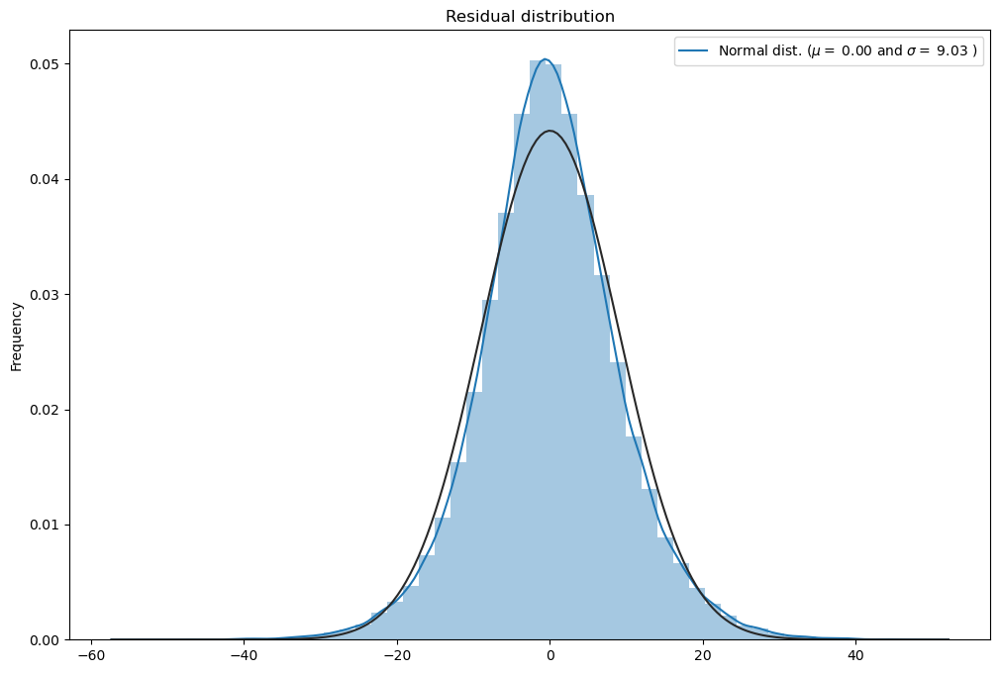

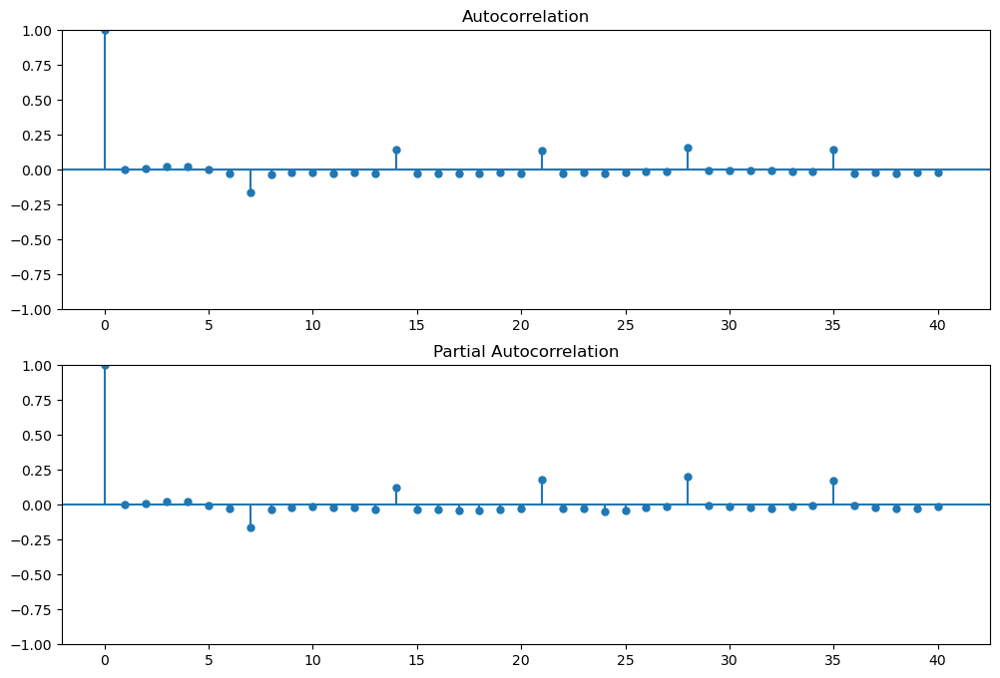

In [ ]:
#Analysis of the residuals (errors) from the ARIMA model

from scipy import stats
from scipy.stats import normaltest

resid = arima_mod6.resid
print(normaltest(resid))
# returns a 2-tuple of the chi-squared statistic, and the associated p-value. the p-value is very small, meaning
# the residual is not a normal distribution

fig = plt.figure(figsize=(12,8))
ax0 = fig.add_subplot(111)

sns.distplot(resid ,fit = stats.norm, ax = ax0) # need to import scipy.stats

# Get the fitted parameters used by the function
(mu, sigma) = stats.norm.fit(resid)

#Now plot the distribution using
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)], loc='best')
plt.ylabel('Frequency')
plt.title('Residual distribution')


# ACF and PACF
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(arima_mod6.resid, lags=40, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(arima_mod6.resid, lags=40, ax=ax2)

Ideally for a good model the residual should be normally distributed, but here as we see although the graph looks very like a normal distribution.
But it failed the test. Also we see a recurring correlation exists in both ACF and PACF. So we need to deal with seasonality.

1. In this output, the p-value is reported as 0.0, which indicates that the probability of observing the test statistic under the null hypothesis (i.e., that the residuals follow a normal distribution) is extremely low.

2. Therefore, based on this result, we reject the null hypothesis and conclude that the residuals are not normally distributed.

# 1. B Modelling using SARIMA

In [ ]:
sarima_mod6 = sm.tsa.statespace.SARIMAX(df_train_.sales, trend='n', order=(7,1,0)).fit()
print(sarima_mod6.summary())

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.61924D+00    |proj g|=  3.13245D-05


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8      1      4      1     0     0   2.914D-05   3.619D+00
  F =   3.6192399728183453     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
                               SARIMAX Results                                
Dep. Variable:                  sales   No. Observations:                91300
Model:               SARIMAX(7, 1, 0)   Log Likelihood             -330436.610
Date:                Sun, 11 Feb 2024   AIC                         660889.219
Time:                        17:47:50   BIC                         660964.594
Sample:                     

In [ ]:
#Exactly similar observations even after using SARIMAX

NormaltestResult(statistic=1922.947643418309, pvalue=0.0)


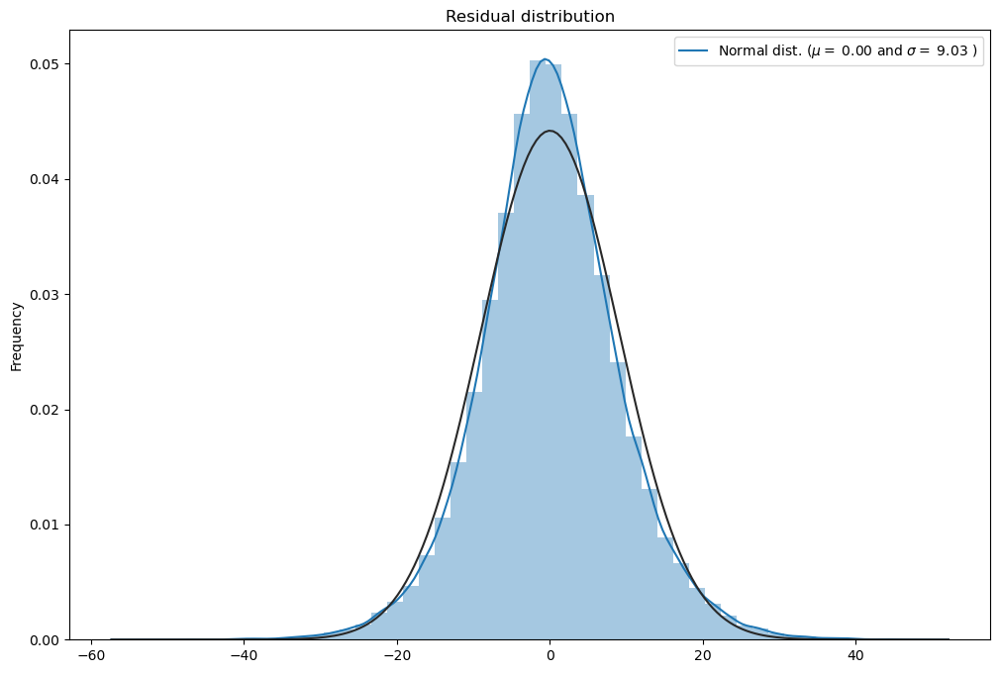

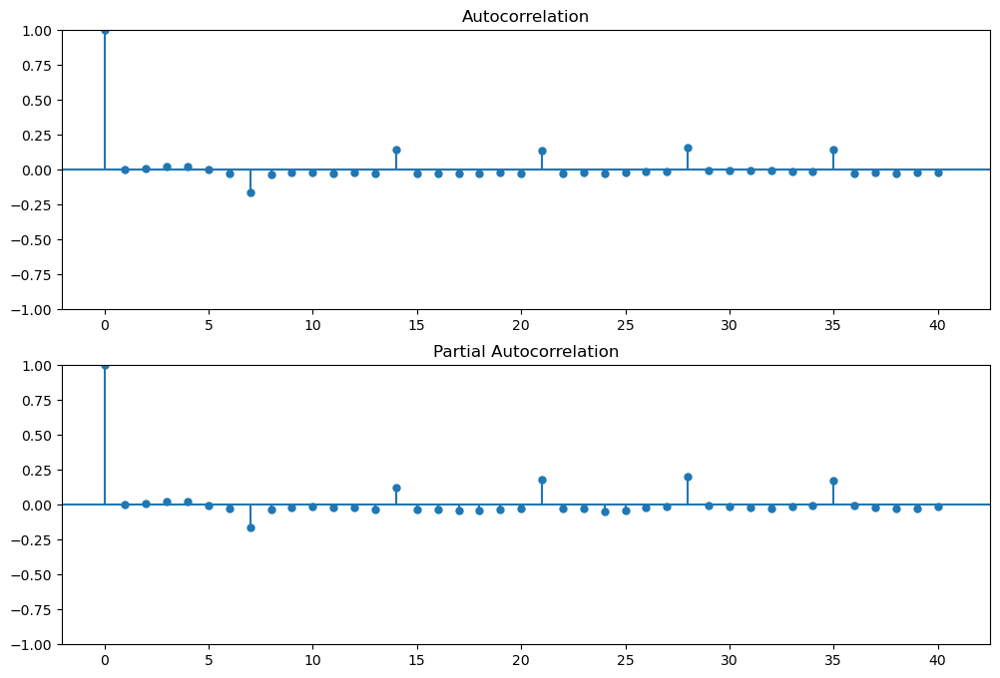

In [ ]:
resid = sarima_mod6.resid
print(normaltest(resid))

fig = plt.figure(figsize=(12,8))
ax0 = fig.add_subplot(111)

sns.distplot(resid ,fit = stats.norm, ax = ax0) # need to import scipy.stats

# Get the fitted parameters used by the function
(mu, sigma) = stats.norm.fit(resid)

#Now plot the distribution using
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)], loc='best')
plt.ylabel('Frequency')
plt.title('Residual distribution')

# ACF and PACF
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(arima_mod6.resid, lags=40, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(arima_mod6.resid, lags=40, ax=ax2)

In [ ]:
#SARIMAX also failed to pass the test

# Forecasting using SARIMAX model

<Axes: >

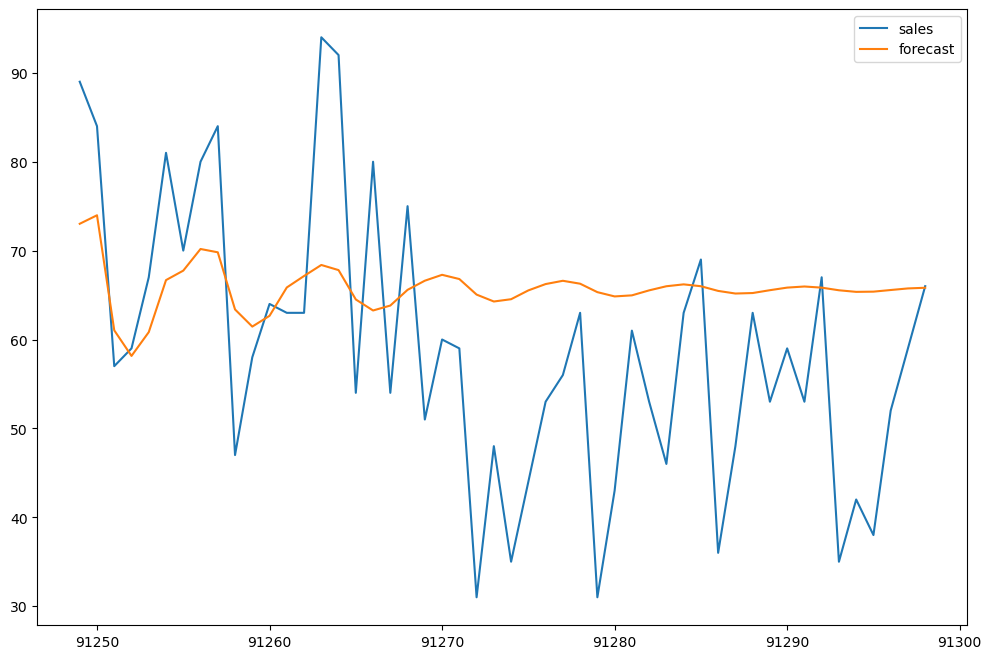

In [ ]:
start_index = 91249
end_index = 91299
df_train_['forecast'] = sarima_mod6.predict(start = start_index, end= end_index, dynamic= True)
df_train_[start_index:end_index][['sales', 'forecast']].plot(figsize=(12, 8))

#The plotted distribution shows very less accuracy. Suggesting the current model is not performing well

In [ ]:
def smape_kun(y_true, y_pred):
    mape = np.mean(abs((y_true-y_pred)/y_true))*100
    smape = np.mean((np.abs(y_pred - y_true) * 200/ (np.abs(y_pred) + np.abs(y_true))).fillna(0))
    print('MAPE: %.2f %% \nSMAPE: %.2f'% (mape,smape), "%")

In [ ]:
smape_kun(df_train_[start_index:end_index]['sales'],df_train_[start_index:end_index]['forecast'])

MAPE: 26.77 % 
SMAPE: 22.05 %


<Axes: >

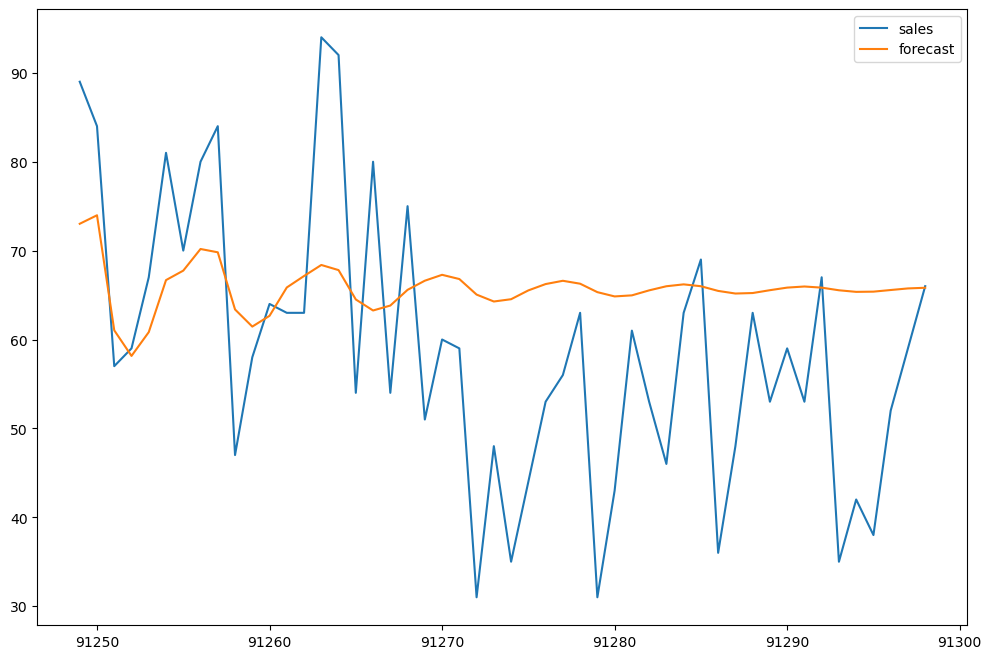

In [ ]:
df_train_['forecast'] = sarima_mod6.predict(start = start_index, end= end_index, dynamic= True)
df_train_[start_index:end_index][['sales', 'forecast']].plot(figsize=(12, 8))

# 2. Modelling with Feature Engineering: Adding extra features

In [ ]:
##Training along with Extra Features
df_train_

,date,store,item,sales,year,month,day,weekday,forecast
0,2013-01-01,1,1,13.0,2013,1,1,1,NaN
1,2013-01-02,1,1,11.0,2013,1,2,2,NaN
2,2013-01-03,1,1,14.0,2013,1,3,3,NaN
3,2013-01-04,1,1,13.0,2013,1,4,4,NaN
4,2013-01-05,1,1,10.0,2013,1,5,5,NaN
...,...,...,...,...,...,...,...,...,...
91295,2017-12-27,1,50,38.0,2017,12,361,2,65.383676
91296,2017-12-28,1,50,52.0,2017,12,362,3,65.567326
91297,2017-12-29,1,50,59.0,2017,12,363,4,65.745747
91298,2017-12-30,1,50,66.0,2017,12,364,5,65.819845


In [ ]:
# Taking per 1 store, 1 item reducing the training set easy pattern identification
storeid = 1
itemid = 1

df_train = df_train[df_train['store']==storeid]
df_train = df_train[df_train['item']==itemid]

# train_df = train_df.set_index('date')
df_train['year'] = df_train['date'].dt.year - 2012
df_train['month'] =  df_train['date'].dt.month
df_train['day'] = df_train['date'].dt.dayofyear
df_train['weekday'] = df_train['date'].dt.weekday

# One hot encoding Categorical Variables

In [ ]:
df_train = pd.get_dummies(df_train,
                          columns = ['month','weekday'] , prefix = ['month','weekday'])

In [ ]:
df_train.columns

Index(['date', 'store', 'item', 'sales', 'year', 'day', 'month_1', 'month_2',
       'month_3', 'month_4', 'month_5', 'month_6', 'month_7', 'month_8',
       'month_9', 'month_10', 'month_11', 'month_12', 'weekday_0', 'weekday_1',
       'weekday_2', 'weekday_3', 'weekday_4', 'weekday_5', 'weekday_6'],
      dtype='object')

In [ ]:
# Convert boolean values to integers (True -> 1, False -> 0)
df_train[['month_1', 'month_2', 'month_3', 'month_4', 'month_5', 'month_6', 'month_7', 'month_8', 'month_9', 'month_10', 'month_11', 'month_12']] = df_train[['month_1', 'month_2', 'month_3', 'month_4', 'month_5', 'month_6', 'month_7', 'month_8', 'month_9', 'month_10', 'month_11', 'month_12']].astype(int)
df_train[['weekday_0', 'weekday_1', 'weekday_2', 'weekday_3', 'weekday_4', 'weekday_5', 'weekday_6']] = df_train[['weekday_0', 'weekday_1', 'weekday_2', 'weekday_3', 'weekday_4', 'weekday_5', 'weekday_6']].astype(int)


In [ ]:
# per 1 store, 1 item
storeid = 1
itemid = 1
df_train_ = df_train_[df_train_['store']==storeid]
df_train_ = df_train_[df_train_['item']==itemid]

# train_df = train_df.set_index('date')
df_train_['year'] = df_train_['date'].dt.year - 2012
df_train_['month'] = df_train_['date'].dt.month
df_train_['day'] = df_train_['date'].dt.dayofyear
df_train_['weekday'] = df_train_['date'].dt.weekday

In [ ]:
exog_data = df_train.drop(["store", "item", "sales"], axis=1)

In [ ]:
df_train = df_train.set_index('date')
exog_data = exog_data.set_index('date')

In [ ]:
start_index = '2017-10-01'
end_index = '2017-12-31'

In [ ]:
exog_data

,year,day,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,...,month_10,month_11,month_12,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
date,,,,,,,,,,,,,,,,,,,,,
2013-01-01,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2013-01-02,1,2,1,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2013-01-03,1,3,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
2013-01-04,1,4,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
2013-01-05,1,5,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-27,5,361,0,0,0,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
2017-12-28,5,362,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,1,0,0,0
2017-12-29,5,363,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0


# 2 A. Sarima Model using Extra Features and reduced train set

In [ ]:
%%time
sarimax_mod6 = sm.tsa.statespace.SARIMAX(endog = df_train.sales[:start_index],
                                        exog = exog_data[:start_index],
                                        trend='n', order=(6,1,0), seasonal_order=(0,1,1,7)).fit()
print(sarimax_mod6.summary())

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           29     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11722D+00    |proj g|=  1.75570D-01

At iterate    5    f=  3.05886D+00    |proj g|=  5.31517D-02

At iterate   10    f=  2.98467D+00    |proj g|=  3.31425D-02

At iterate   15    f=  2.98276D+00    |proj g|=  2.35291D-02

At iterate   20    f=  2.97075D+00    |proj g|=  4.51594D-02

At iterate   25    f=  2.96095D+00    |proj g|=  1.09187D-01

At iterate   30    f=  2.96030D+00    |proj g|=  3.07168D-03

At iterate   35    f=  2.96028D+00    |proj g|=  2.72116D-03

At iterate   40    f=  2.96027D+00    |proj g|=  7.99477D-03

At iterate   45    f=  2.96012D+00    |proj g|=  1.40204D-02

At iterate   50    f=  2.95967D+00    |proj g|=  1.26141D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

# Key Observations

In [ ]:
#1. Log likelihood has increased compared to 1A,B models here suggesting that the fit has become better
#2. AIC, BIC, HQIC: Values have also reduced significantly, suggesting better fit
#3. Ljung-Box (Q) statistic of 0.92 suggests that there is some autocorrelation present in the residuals at lag 1. The residuals at one time point are correlated with the residuals at the immediately preceding time point.
#5. The Jarque-Bera (JB) statistic is a test of the skewness and kurtosis of the residuals from a regression analysis. In this context, a JB statistic of 4146.18(previous) to 39.85 indicates that the distribution of the residuals is near normal distribution
#6. Positive skewness (greater than 0) indicates that the distribution right skewed(tail)
#7. Kurtosis indicates higher number of outliers in the data (we previously observed that also through visual inspection) but has reduced in the current model
#8. Heteroskedasticity also observed suggesting -- variance of the errors (or residuals) in a regression model is not constant across all levels of the independent variables has increased

In [ ]:
#90 days prediction
start_index = '2017-10-01'
end_index = '2017-12-30'
end_index1 = '2017-12-31'

In [ ]:
end_index

'2017-12-30'

<Axes: xlabel='date'>

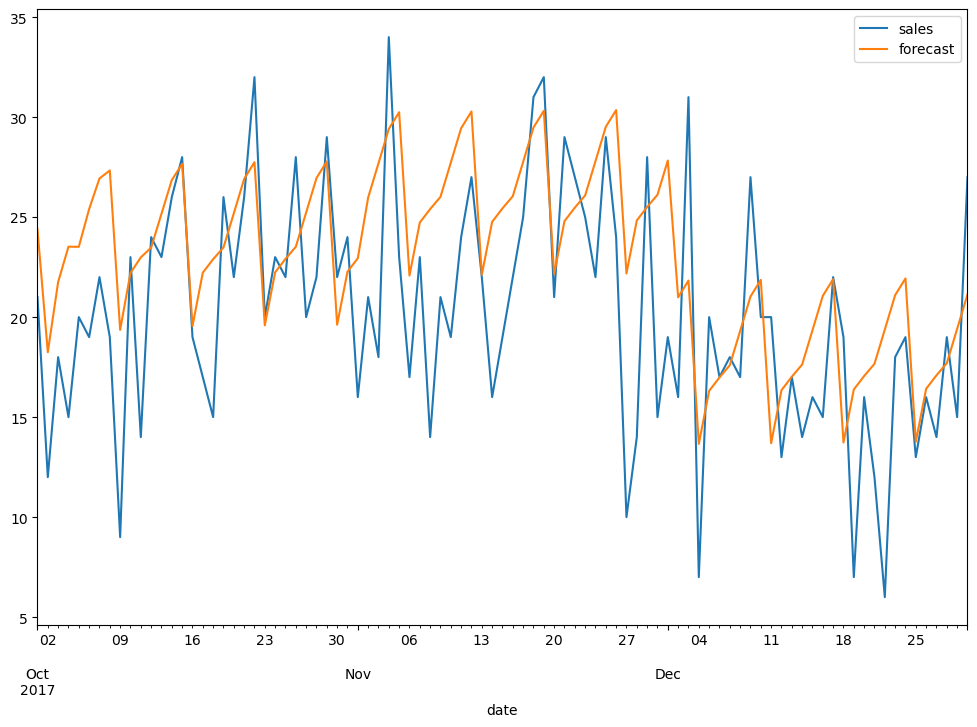

In [ ]:
df_train['forecast'] = sarimax_mod6.predict(start = pd.to_datetime(start_index), end= pd.to_datetime(end_index1),
                                            exog = exog_data[start_index:end_index],
                                            dynamic= True)

df_train[start_index:end_index][['sales', 'forecast']].plot(figsize=(12, 8))


In [ ]:
#Accuracy Metrics
smape_kun(df_train[start_index:end_index]['sales'],df_train[start_index:end_index]['forecast'])

MAPE: 27.95 % 
SMAPE: 22.22 %


In [ ]:
df_predict

,id,date,store,item,year,month,day,weekday
0,0,2018-01-01,1,1,2018,1,1,0
1,1,2018-01-02,1,1,2018,1,2,1
2,2,2018-01-03,1,1,2018,1,3,2
3,3,2018-01-04,1,1,2018,1,4,3
4,4,2018-01-05,1,1,2018,1,5,4
...,...,...,...,...,...,...,...,...
44995,44995,2018-03-27,10,50,2018,3,86,1
44996,44996,2018-03-28,10,50,2018,3,87,2
44997,44997,2018-03-29,10,50,2018,3,88,3
44998,44998,2018-03-30,10,50,2018,3,89,4


# 3. Modelling using Multilayer Perceptron

In [ ]:
#As observed train data has the target variable (sales) whereas test data doesnt, which we have to predict in this time series forecasting
df_train = pd.read_csv("training_data.csv", parse_dates=['date'])
df_predict = pd.read_csv("predict_data.csv", parse_dates=['date'])

In [ ]:
df_train

,date,store,item,sales
0,2013-01-01,1,1,13.0
1,2013-02-01,1,1,11.0
2,2013-03-01,1,1,14.0
3,2013-04-01,1,1,13.0
4,2013-05-01,1,1,10.0
...,...,...,...,...
912995,2017-12-27,10,50,63.0
912996,2017-12-28,10,50,59.0
912997,2017-12-29,10,50,74.0
912998,2017-12-30,10,50,62.0


In [ ]:
#Taking 1 year data of 2017 -- Taking recent data considering the fact that it will better align with the
#upcoming 90 days prediction
train = df_train[(df_train['date'] >= '2017-01-01')]

In [ ]:
df_predict

,id,date,store,item
0,0,2018-01-01,1,1
1,1,2018-01-02,1,1
2,2,2018-01-03,1,1
3,3,2018-01-04,1,1
4,4,2018-01-05,1,1
...,...,...,...,...
44995,44995,2018-03-27,10,50
44996,44996,2018-03-28,10,50
44997,44997,2018-03-29,10,50
44998,44998,2018-03-30,10,50


In [ ]:
train_gp = train.sort_values('date').groupby(['item', 'store', 'date'], as_index=False)
train_gp = train_gp.agg({'sales':['mean']}) #Calculates the mean of the 'sales' column within each group.
train_gp.columns = ['item', 'store', 'date', 'sales']
print(train_gp.shape)
train_gp.head()

(182500, 4)


,item,store,date,sales
0,1,1,2017-01-01,19.0
1,1,1,2017-01-02,15.0
2,1,1,2017-01-03,16.0
3,1,1,2017-01-04,26.0
4,1,1,2017-01-05,15.0


In [ ]:
def series_to_supervised(data, window=29, lag=1, dropnan=True):
    """
    This function converts the time series dataset into supervised learning problem.
    data: The input time series DataFrame,
    window: The number of lag observations to use as input features,
    lag: The number of future observations to predict

    """
    cols, names = list(), list()
    # Input sequence (t-n, ... t-1)
    for i in range(window, 0, -1):
        cols.append(data.shift(i))
        names += [('%s(t-%d)' % (col, i)) for col in data.columns]
    # Current timestep (t=0)
    cols.append(data)
    names += [('%s(t)' % (col)) for col in data.columns]
    # Target timestep (t=lag)
    cols.append(data.shift(-lag))
    names += [('%s(t+%d)' % (col, lag)) for col in data.columns]
    # Put it all together
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # Drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg

In [ ]:
# We will use the current timestep and the last 29(Capture complete cycle of seasonality) to forecast 90 days ahead¶
lag_size = 90
window = 29
lag = lag_size
series = series_to_supervised(train_gp.drop('date', axis=1), window=window, lag=lag)
series.head()

,item(t-29),store(t-29),sales(t-29),item(t-28),store(t-28),sales(t-28),item(t-27),store(t-27),sales(t-27),item(t-26),...,sales(t-2),item(t-1),store(t-1),sales(t-1),item(t),store(t),sales(t),item(t+90),store(t+90),sales(t+90)
29,1.0,1.0,19.0,1.0,1.0,15.0,1.0,1.0,16.0,1.0,...,16.0,1.0,1.0,24.0,1,1,9.0,1.0,1.0,33.0
30,1.0,1.0,15.0,1.0,1.0,16.0,1.0,1.0,26.0,1.0,...,24.0,1.0,1.0,9.0,1,1,17.0,1.0,1.0,14.0
31,1.0,1.0,16.0,1.0,1.0,26.0,1.0,1.0,15.0,1.0,...,9.0,1.0,1.0,17.0,1,1,15.0,1.0,1.0,25.0
32,1.0,1.0,26.0,1.0,1.0,15.0,1.0,1.0,29.0,1.0,...,17.0,1.0,1.0,15.0,1,1,17.0,1.0,1.0,25.0
33,1.0,1.0,15.0,1.0,1.0,29.0,1.0,1.0,31.0,1.0,...,15.0,1.0,1.0,17.0,1,1,23.0,1.0,1.0,21.0


In [ ]:
series.shape

(161045, 93)

In [ ]:
#Filtering the DataFrame series to include only rows where the value of the 'store(t)' column matches the value of the 'store(t-window)' column and where the value of the 'item(t)' column matches the value of the 'item(t-window)' column.
last_item = 'item(t-%d)' % window
last_store = 'store(t-%d)' % window
series = series[(series['store(t)'] == series[last_store])]
series = series[(series['item(t)'] == series[last_item])]

In [ ]:
#Remove unwanted columns
columns_to_drop = [('%s(t+%d)' % (col, lag)) for col in ['item', 'store']]
for i in range(window, 0, -1):
    columns_to_drop += [('%s(t-%d)' % (col, i)) for col in ['item', 'store']]
series.drop(columns_to_drop, axis=1, inplace=True)
series.drop(['item(t)', 'store(t)'], axis=1, inplace=True)

In [ ]:
series.columns

Index(['sales(t-29)', 'sales(t-28)', 'sales(t-27)', 'sales(t-26)',
       'sales(t-25)', 'sales(t-24)', 'sales(t-23)', 'sales(t-22)',
       'sales(t-21)', 'sales(t-20)', 'sales(t-19)', 'sales(t-18)',
       'sales(t-17)', 'sales(t-16)', 'sales(t-15)', 'sales(t-14)',
       'sales(t-13)', 'sales(t-12)', 'sales(t-11)', 'sales(t-10)',
       'sales(t-9)', 'sales(t-8)', 'sales(t-7)', 'sales(t-6)', 'sales(t-5)',
       'sales(t-4)', 'sales(t-3)', 'sales(t-2)', 'sales(t-1)', 'sales(t)',
       'sales(t+90)'],
      dtype='object')

In [ ]:
series

,sales(t-29),sales(t-28),sales(t-27),sales(t-26),sales(t-25),sales(t-24),sales(t-23),sales(t-22),sales(t-21),sales(t-20),...,sales(t-8),sales(t-7),sales(t-6),sales(t-5),sales(t-4),sales(t-3),sales(t-2),sales(t-1),sales(t),sales(t+90)
29,19.0,15.0,16.0,26.0,15.0,29.0,31.0,18.0,38.0,21.0,...,21.0,9.0,18.0,14.0,13.0,10.0,16.0,24.0,9.0,33.0
30,15.0,16.0,26.0,15.0,29.0,31.0,18.0,38.0,21.0,16.0,...,9.0,18.0,14.0,13.0,10.0,16.0,24.0,9.0,17.0,14.0
31,16.0,26.0,15.0,29.0,31.0,18.0,38.0,21.0,16.0,19.0,...,18.0,14.0,13.0,10.0,16.0,24.0,9.0,17.0,15.0,25.0
32,26.0,15.0,29.0,31.0,18.0,38.0,21.0,16.0,19.0,7.0,...,14.0,13.0,10.0,16.0,24.0,9.0,17.0,15.0,17.0,25.0
33,15.0,29.0,31.0,18.0,38.0,21.0,16.0,19.0,7.0,16.0,...,13.0,10.0,16.0,24.0,9.0,17.0,15.0,17.0,23.0,21.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
182405,79.0,89.0,46.0,61.0,81.0,114.0,97.0,101.0,135.0,80.0,...,72.0,89.0,97.0,97.0,99.0,63.0,79.0,80.0,82.0,63.0
182406,89.0,46.0,61.0,81.0,114.0,97.0,101.0,135.0,80.0,93.0,...,89.0,97.0,97.0,99.0,63.0,79.0,80.0,82.0,90.0,59.0
182407,46.0,61.0,81.0,114.0,97.0,101.0,135.0,80.0,93.0,69.0,...,97.0,97.0,99.0,63.0,79.0,80.0,82.0,90.0,103.0,74.0
182408,61.0,81.0,114.0,97.0,101.0,135.0,80.0,93.0,69.0,89.0,...,97.0,99.0,63.0,79.0,80.0,82.0,90.0,103.0,50.0,62.0


In [ ]:
# Label
labels_col = 'sales(t+%d)' % lag_size
labels = series[labels_col]
series = series.drop(labels_col, axis=1)

X_train, X_valid, Y_train, Y_valid = train_test_split(series, labels.values, test_size=0.4, random_state=0)
print('Train set shape', X_train.shape)
print('Validation set shape', X_valid.shape)
X_train.head()

Train set shape (88918, 30)
Validation set shape (59280, 30)


,sales(t-29),sales(t-28),sales(t-27),sales(t-26),sales(t-25),sales(t-24),sales(t-23),sales(t-22),sales(t-21),sales(t-20),...,sales(t-9),sales(t-8),sales(t-7),sales(t-6),sales(t-5),sales(t-4),sales(t-3),sales(t-2),sales(t-1),sales(t)
5579,44.0,52.0,62.0,38.0,41.0,47.0,34.0,41.0,52.0,63.0,...,78.0,58.0,60.0,36.0,49.0,62.0,30.0,64.0,59.0,56.0
36275,123.0,121.0,81.0,93.0,83.0,105.0,92.0,99.0,124.0,64.0,...,78.0,114.0,141.0,74.0,95.0,99.0,93.0,104.0,126.0,122.0
109078,38.0,63.0,62.0,36.0,58.0,41.0,49.0,49.0,65.0,40.0,...,66.0,50.0,43.0,43.0,41.0,26.0,30.0,43.0,39.0,57.0
43563,82.0,98.0,58.0,108.0,84.0,102.0,87.0,78.0,90.0,85.0,...,110.0,62.0,72.0,81.0,92.0,98.0,84.0,86.0,125.0,83.0
34824,47.0,65.0,59.0,56.0,73.0,66.0,65.0,78.0,60.0,57.0,...,97.0,64.0,58.0,75.0,68.0,73.0,84.0,84.0,47.0,67.0


In [ ]:
labels_col

'sales(t+90)'

In [ ]:
epochs = 40
batch = 256
lr = 0.0003
adam = optimizers.Adam(lr)

In [ ]:
model_mlp = Sequential()
model_mlp.add(Dense(100, activation='relu', input_dim=X_train.shape[1]))
model_mlp.add(Dense(1))
model_mlp.compile(loss='mse', optimizer=adam)
model_mlp.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 100)               3100      
                                                                 
 dense_1 (Dense)             (None, 1)                 101       
                                                                 
Total params: 3201 (12.50 KB)
Trainable params: 3201 (12.50 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
mlp_history = model_mlp.fit(X_train.values, Y_train, validation_data=(X_valid.values, Y_valid), epochs=epochs, verbose=2)
mlp_history

Epoch 1/40
2779/2779 - 9s - loss: 359.5090 - val_loss: 312.7390 - 9s/epoch - 3ms/step
Epoch 2/40
2779/2779 - 7s - loss: 311.4695 - val_loss: 305.8682 - 7s/epoch - 3ms/step
Epoch 3/40
2779/2779 - 6s - loss: 296.7614 - val_loss: 281.5051 - 6s/epoch - 2ms/step
Epoch 4/40
2779/2779 - 8s - loss: 288.3812 - val_loss: 280.5698 - 8s/epoch - 3ms/step
Epoch 5/40
2779/2779 - 7s - loss: 279.4940 - val_loss: 277.0121 - 7s/epoch - 2ms/step
Epoch 6/40
2779/2779 - 7s - loss: 272.4455 - val_loss: 259.5066 - 7s/epoch - 3ms/step
Epoch 7/40
2779/2779 - 6s - loss: 267.7543 - val_loss: 263.7529 - 6s/epoch - 2ms/step
Epoch 8/40
2779/2779 - 7s - loss: 263.1125 - val_loss: 258.0482 - 7s/epoch - 2ms/step
Epoch 9/40
2779/2779 - 6s - loss: 259.2056 - val_loss: 264.7449 - 6s/epoch - 2ms/step
Epoch 10/40
2779/2779 - 7s - loss: 256.9669 - val_loss: 260.4725 - 7s/epoch - 2ms/step
Epoch 11/40
2779/2779 - 7s - loss: 252.5152 - val_loss: 248.1069 - 7s/epoch - 2ms/step
Epoch 12/40
2779/2779 - 7s - loss: 251.0889 - val_lo

In [ ]:
mlp_train_pred = model_mlp.predict(X_train.values)
mlp_valid_pred = model_mlp.predict(X_valid.values)
print('Train rmse:', np.sqrt(mean_squared_error(Y_train, mlp_train_pred)))
print('Validation rmse:', np.sqrt(mean_squared_error(Y_valid, mlp_valid_pred)))

1853/1853 [==============================] - 2s 1ms/step
Train rmse: 15.006557492184522
Validation rmse: 15.082496480198829


In [ ]:
X_valid

,sales(t-29),sales(t-28),sales(t-27),sales(t-26),sales(t-25),sales(t-24),sales(t-23),sales(t-22),sales(t-21),sales(t-20),...,sales(t-9),sales(t-8),sales(t-7),sales(t-6),sales(t-5),sales(t-4),sales(t-3),sales(t-2),sales(t-1),sales(t)
172517,83.0,98.0,103.0,57.0,48.0,38.0,58.0,71.0,37.0,67.0,...,76.0,88.0,80.0,80.0,37.0,75.0,72.0,70.0,70.0,73.0
126261,62.0,56.0,96.0,66.0,87.0,47.0,48.0,51.0,31.0,38.0,...,57.0,63.0,59.0,39.0,64.0,47.0,56.0,31.0,50.0,55.0
125246,39.0,40.0,55.0,41.0,63.0,71.0,55.0,51.0,49.0,37.0,...,68.0,40.0,49.0,68.0,61.0,56.0,62.0,85.0,52.0,52.0
110937,67.0,84.0,48.0,44.0,77.0,59.0,79.0,86.0,91.0,91.0,...,84.0,45.0,63.0,79.0,62.0,90.0,72.0,64.0,79.0,57.0
87708,60.0,65.0,71.0,82.0,90.0,87.0,56.0,69.0,80.0,88.0,...,78.0,118.0,43.0,88.0,86.0,88.0,128.0,55.0,88.0,85.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77675,138.0,89.0,102.0,83.0,107.0,120.0,115.0,65.0,91.0,101.0,...,117.0,135.0,77.0,91.0,99.0,97.0,92.0,124.0,117.0,82.0
7273,104.0,74.0,76.0,71.0,64.0,94.0,52.0,65.0,75.0,77.0,...,105.0,60.0,72.0,73.0,80.0,49.0,53.0,79.0,74.0,80.0
176206,43.0,37.0,66.0,47.0,48.0,30.0,38.0,35.0,45.0,40.0,...,29.0,33.0,28.0,36.0,55.0,45.0,19.0,29.0,36.0,23.0
153144,65.0,38.0,33.0,41.0,56.0,51.0,48.0,51.0,30.0,40.0,...,59.0,69.0,78.0,67.0,51.0,50.0,58.0,67.0,84.0,65.0


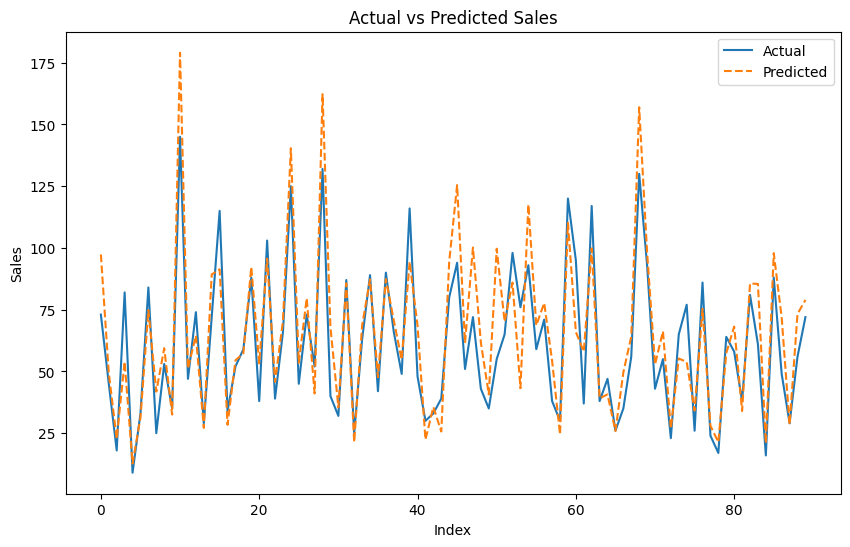

In [ ]:
import matplotlib.pyplot as plt

# Plotting actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(Y_valid[-90:], label='Actual')
plt.plot(mlp_valid_pred[-90:], label='Predicted', linestyle='--')
plt.title('Actual vs Predicted Sales')
plt.xlabel('Index')
plt.ylabel('Sales')
plt.legend()
plt.show()

# Forecasting for predict.csv dataset

#We need to forecast sales for the next 90 days following the training set.
#To do this, we require the last row of the training set to generate our prediction dataset  that can be fed into the model to predict sales for the next 90 days.

#From the training set:
Minimum date: 2013-01-01
Maximum date: 2017-12-31

#From the prediction set:
Minimum date: 2018-01-01
Maximum date: 2018-03-31

In [ ]:
df_predict

,id,date,store,item
0,0,2018-01-01,1,1
1,1,2018-01-02,1,1
2,2,2018-01-03,1,1
3,3,2018-01-04,1,1
4,4,2018-01-05,1,1
...,...,...,...,...
44995,44995,2018-03-27,10,50
44996,44996,2018-03-28,10,50
44997,44997,2018-03-29,10,50
44998,44998,2018-03-30,10,50


In [ ]:
#Using the last row of series from train set
last_row = series.iloc[-1]
last_row

sales(t-29)     81.0
sales(t-28)    114.0
sales(t-27)     97.0
sales(t-26)    101.0
sales(t-25)    135.0
sales(t-24)     80.0
sales(t-23)     93.0
sales(t-22)     69.0
sales(t-21)     89.0
sales(t-20)     69.0
sales(t-19)     84.0
sales(t-18)     90.0
sales(t-17)     94.0
sales(t-16)     97.0
sales(t-15)    107.0
sales(t-14)     61.0
sales(t-13)     84.0
sales(t-12)     72.0
sales(t-11)     89.0
sales(t-10)     97.0
sales(t-9)      97.0
sales(t-8)      99.0
sales(t-7)      63.0
sales(t-6)      79.0
sales(t-5)      80.0
sales(t-4)      82.0
sales(t-3)      90.0
sales(t-2)     103.0
sales(t-1)      50.0
sales(t)        68.0
Name: 182409, dtype: float64

In [ ]:
# Each prediction set will provide us with forecasts for the next day.
# We'll incorporate each prediction into the updated series to forecast sales for the following day.
next_90_days_features = last_row.values.reshape(1, -1)
next_90_days_predictions = model_mlp.predict(next_90_days_features)
next_90_days_predictions

1/1 [==============================] - 0s 25ms/step


array([[77.82974]], dtype=float32)

In [ ]:
#List to store predictions
predictions = []

#Input features with the last_row
next_day_features = last_row.values.reshape(1, -1)

# Iterate over the next 90 days
for _ in range(90):
    # Make a prediction for the next day
    next_day_prediction = model_mlp.predict(next_day_features)

    # Append the prediction to the list of predictions
    predictions.append(next_day_prediction)

    # Update the input features for the next prediction by shifting the values to the left
    next_day_features = np.roll(next_day_features, -1)
    next_day_features[0, -1] = next_day_prediction  # Set the last value to the predicted value

# Convert the list of predictions to a numpy array
predictions_array = np.array(predictions)


1/1 [==============================] - 0s 21ms/step


In [ ]:
#90 days prediction of Sales
predictions_array

array([[[77.82974 ]],

       [[67.94505 ]],

       [[57.002586]],

       [[68.57713 ]],

       [[78.872826]],

       [[62.213406]],

       [[68.60208 ]],

       [[92.96338 ]],

       [[72.56168 ]],

       [[67.81166 ]],

       [[78.74807 ]],

       [[71.31216 ]],

       [[65.360725]],

       [[74.732124]],

       [[66.33715 ]],

       [[63.7449  ]],

       [[61.856415]],

       [[71.834015]],

       [[64.35764 ]],

       [[62.65638 ]],

       [[74.78325 ]],

       [[67.54117 ]],

       [[61.371944]],

       [[64.32275 ]],

       [[63.191612]],

       [[56.051613]],

       [[65.89773 ]],

       [[60.26739 ]],

       [[59.675163]],

       [[53.89014 ]],

       [[59.67476 ]],

       [[54.623962]],

       [[56.38672 ]],

       [[60.88794 ]],

       [[57.292725]],

       [[53.39312 ]],

       [[59.286964]],

       [[59.455185]],

       [[50.10208 ]],

       [[56.670303]],

       [[55.663883]],

       [[48.113903]],

       [[48.642124]],

       [[52

# Future improvements
1. Explore techniques for multivariate analysis using deep learning
2. Hyperparameter Tuning
3. Explore more Deep Learning Algorithms to potentially improve forecasting accuracy.

In [1]:
#End of Code